In [0]:
import nyutransforms as nyuT
import nyudepth as nyu
import torch.utils.data as data

transforms = nyuT.Compose([
    nyuT.ToPILImage(),
    nyuT.PILDownsample(),
    nyuT.RandomRotation((-5, 5)), 
    nyuT.Scale(1.0, 1.5), 
    nyuT.RandomHorizontalFlip(p=0.5), 
    nyuT.RandomCrop((228, 304),(228, 304)), 
    nyuT.ToTensor(), 
    nyuT.ColorTransformation((0.8, 1.2))
])

transforms2 = nyuT.Compose([nyuT.Downsample(),
                          nyuT.CenterCrop(),
                          nyuT.ToTensor()])

dataset = nyu.NYUDepthV2Dataset('/content/drive/My Drive/zavrsni/data/nyuall.mat', transform=transforms, all_file=True)
dataset_val = nyu.NYUDepthV2Dataset('/content/drive/My Drive/zavrsni/data/test', transform=transforms2, all_file=False)
dataloader = data.DataLoader(dataset, batch_size=16, shuffle=True)

In [0]:
import torch.optim as optim
import loss as L
import matplotlib.pyplot as plt
import torch.nn.functional as F
import torch
import mynn
import math
import torch.optim as opt
import torch.nn as nn
import error


device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
net = mynn.create_mynet()
optimizer = optim.SGD(net.parameters(), lr=1e-2, momentum=0.9, weight_decay=0.0005)
scheduler = opt.lr_scheduler.StepLR(optimizer, step_size=6, gamma=0.1)

berHu = L.ReverseHuberLoss()

cp = torch.load('/content/drive/My Drive/zavrsni/nyu_net_berHu5.tar')

losses_in_epoch = cp['losses']
train_errors_mse = cp['train_errors_mse']
val_errors_mse = cp['val_errors_mse']

print(losses_in_epoch)
print(train_errors_mse)
print(val_errors_mse)

net.load_state_dict(cp['model_state_dict'])
net.to(device)
net.train()
start = cp['epoch']
optimizer.load_state_dict(cp['optimizer_state_dict'])
scheduler.load_state_dict(cp['sch'])
scheduler.step()

for epoch in range(start+1, 20):
    losses = []
    print('epoch >', epoch)
    print('lr =', optimizer.param_groups[0]['lr'])
    for _ in range(8):
        loss_total = 0
        for i, sample in enumerate(dataloader):
            inputs, depths = sample['image'], sample['depth']
            inputs, depths = inputs.to(device), depths.to(device)
            optimizer.zero_grad()

            outputs = net(inputs)
            size_ = depths.shape[2], depths.shape[3]
            outputs = F.interpolate(outputs, size=size_, mode='nearest')

            loss = berHu(depths, outputs)
            loss_total += loss.item()
            losses.append(loss.item())
            loss.backward()
            optimizer.step()

        loss_avg = float(loss_total)/i
        print('epoch: %d > loss: %.9f' % (epoch, loss_avg))
    
    train_errors = error.calc_err(net, dataset)
    val_errors = error.calc_err(net, dataset_val)
    net.train()
    train_errors_mse.append(train_errors)
    val_errors_mse.append(val_errors)
    
    losses_in_epoch[epoch+1] = losses
    scheduler.step()
    torch.save({
        'sch': scheduler.state_dict(),
        'epoch': epoch,
        'model_state_dict': net.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'losses': losses_in_epoch,
        'train_errors_mse': train_errors_mse,
        'val_errors_mse': val_errors_mse
      }, '/content/drive/My Drive/zavrsni/nyu_net_berHu5.tar')
  
print("Finished training")
torch.save(net.state_dict(), '/content/drive/My Drive/zavrsni/nyu_net_berHu5.pt')


{1: [2.608701705932617, 2.1345415115356445, 3.0580790042877197, 2.32499623298645, 3.064828395843506, 2.3711140155792236, 2.3145556449890137, 2.139349937438965, 2.1099321842193604, 2.0914268493652344, 2.1167728900909424, 2.0276505947113037, 2.212005615234375, 1.7015317678451538, 1.731248378753662, 1.3518712520599365, 1.2167640924453735, 0.9231682419776917, 1.0098193883895874, 0.7685393691062927, 0.9200144410133362, 0.9800720810890198, 1.1655138731002808, 1.1308658123016357, 0.9751771688461304, 0.9029848575592041, 1.0910415649414062, 1.1046464443206787, 0.9955509901046753, 1.026534080505371, 0.8938392400741577, 0.9446272850036621, 0.8824238777160645, 0.9120697379112244, 1.0851385593414307, 1.0942703485488892, 0.9096093773841858, 1.0826466083526611, 0.8097918629646301, 0.8573900461196899, 0.9196521043777466, 1.0873675346374512, 1.0488276481628418, 1.106575608253479, 1.0088108777999878, 0.960188627243042, 0.8611242175102234, 0.8343258500099182, 0.7269505858421326, 0.8705340027809143, 0.729

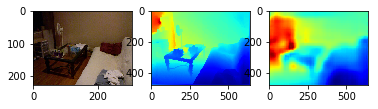

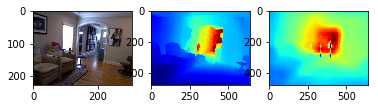

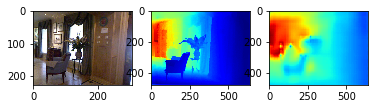

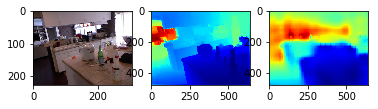

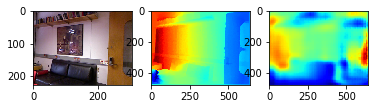

...

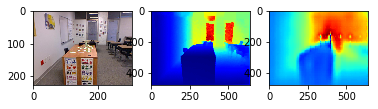

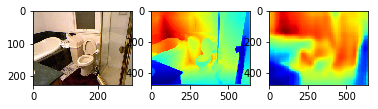

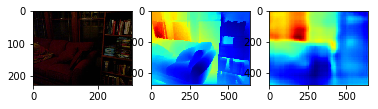

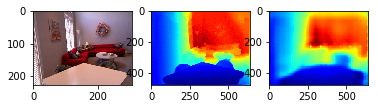

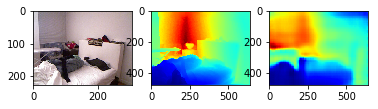

In [0]:
import nyutransforms as nyuT
import nyudepth as nyu
import torch.utils.data as data
import matplotlib.pyplot as plt
import mynn
import torch
import torch.nn.functional as F


transforms2 = nyuT.Compose([nyuT.Downsample(), nyuT.CenterCrop(), nyuT.ToTensor()])
dataset_val = nyu.NYUDepthV2Dataset('/content/drive/My Drive/zavrsni/data/test', transform=transforms2, all_file=False)
dataloader = data.DataLoader(dataset_val,  batch_size=1, shuffle=False)

device = torch.device("cpu")

net = mynn.create_mynet()
net.load_state_dict(torch.load('/content/drive/My Drive/zavrsni/nyu_net_berHu4.pt'))
net.to(device)
net.eval()

for i, sample in enumerate(dataloader):
  image, depth = sample['image'], sample['depth']
  output = net(image)
  output = F.interpolate(output, size=(480, 640), mode='nearest')

  output = torch.squeeze(output).detach().numpy()
  depth = torch.squeeze(depth).detach().numpy()
  image = torch.squeeze(image).detach().numpy().transpose((1, 2, 0))
  
  plt.subplot(131)
  plt.imshow(image)
  plt.subplot(132)
  plt.imshow(depth, cmap='jet')
  plt.subplot(133)
  plt.imshow(output, cmap='jet')
  plt.show()



In [0]:
import error
import nyutransforms as nyuT
import nyudepth as nyu
import torch.utils.data as data
import matplotlib.pyplot as plt
import mynn
import torch
import torch.nn.functional as F
import numpy as np


transforms2 = nyuT.Compose([nyuT.Downsample(), nyuT.CenterCrop(), nyuT.ToTensor()])
dataset_val = nyu.NYUDepthV2Dataset('/content/drive/My Drive/zavrsni/data/test', transform=transforms2, all_file=False)
dataloader = data.DataLoader(dataset_val,  batch_size=1, shuffle=True)

device = torch.device("cpu")

net = mynn.create_mynet()
net.load_state_dict(torch.load('/content/drive/My Drive/zavrsni/nyu_net_berHu4.pt'))
net.to(device)
net.eval()
mse = error.calc_err(net, dataset_val)
print(np.sqrt(mse))

    Prosječna kvadratna pogreška: 0.38716049427772276
0.6222222225842812
